In [45]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import scipy.signal as signal
import cv2

In [46]:
def manual_convolve_4(kernel, img, x, y):
    result = 0
    middle = len(kernel) // 2
    for i in range(middle * -1, middle + 1):
        for j in range(middle * -1, middle + 1):
            result += kernel[i + middle][j + middle] * img[i + x][j + y]
    return result

def manual_convolve_2(kernel, img):
    return np.sum(kernel * img)

def convolution(img, kernel):
    padding = len(kernel) // 2
    padded_img = np.pad(img, pad_width = padding, mode = 'constant')

    result4 = np.zeros_like(padded_img, dtype = float)

    result2 = np.zeros_like(padded_img, dtype = float)

    for i in range(padding, len(padded_img) - padding):
        for j in range(padding, len(padded_img[0]) - padding):
            result4[i][j] = manual_convolve_4(kernel, padded_img, i, j)
            result2[i][j] = manual_convolve_2(kernel, padded_img[i - padding : i + padding + 1, j - padding : j + padding + 1])

    unpadded_result4 = result4[padding : -padding, padding : -padding]
    unpadded_result2 = result2[padding : -padding, padding : -padding]

    return unpadded_result4, unpadded_result2


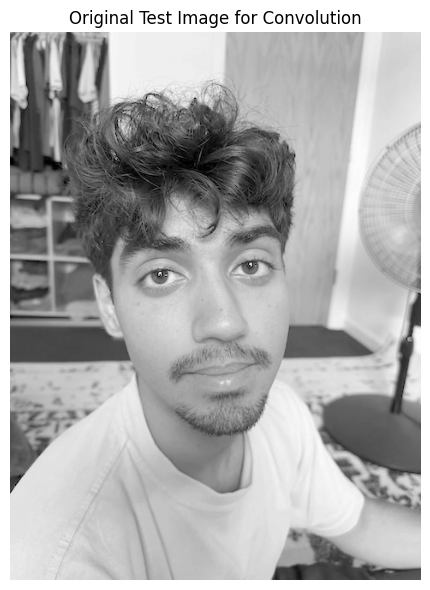

In [47]:
img = Image.open('./images/convolution_img.jpeg').convert('L')
img = np.array(img)
plt.figure(figsize=(8, 6))
plt.imshow(img, cmap = 'gray')
plt.title('Original Test Image for Convolution')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/01_original_convolution_test.png', dpi=150, bbox_inches='tight')
plt.show()

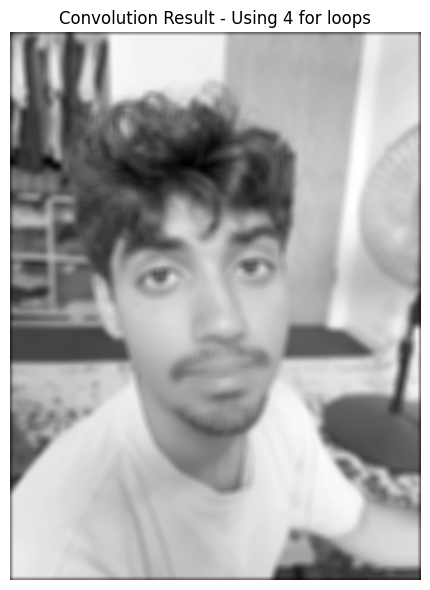

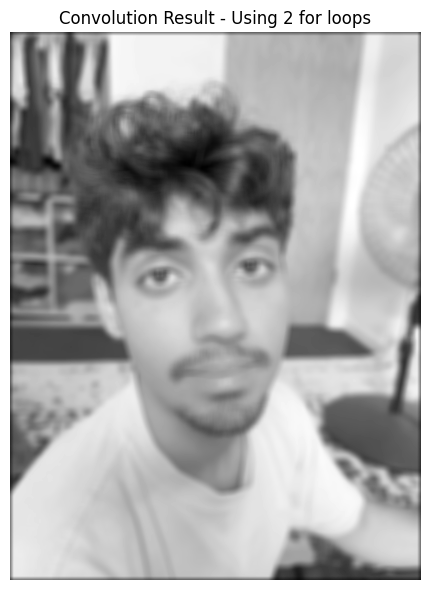

In [48]:
kernel = np.ones((9, 9), dtype = float) / 81

result4, result2 = convolution(img, kernel)

plt.figure(figsize=(8, 6))
plt.imshow(result4, cmap = 'gray')
plt.title('Convolution Result - Using 4 for loops')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/02_convolution_4_loops.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8, 6))
plt.imshow(result2, cmap = 'gray')
plt.title('Convolution Result - Using 2 for loops')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/03_convolution_2_loops.png', dpi=150, bbox_inches='tight')
plt.show()

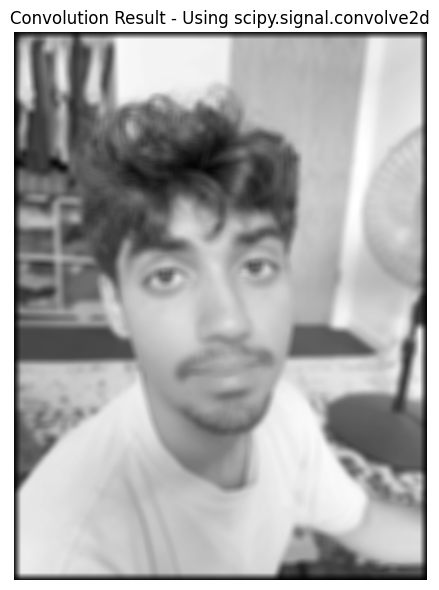

In [49]:
lib_img = signal.convolve2d(img, kernel)
plt.figure(figsize=(8, 6))
plt.imshow(lib_img, cmap = 'gray')
plt.title('Convolution Result - Using scipy.signal.convolve2d')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/04_convolution_scipy.png', dpi=150, bbox_inches='tight')
plt.show()

In [50]:
def direction_diff(img):
    kernel = np.array([1, 0, -1])
    img = np.pad(img, pad_width = 1, mode = 'constant')
    resultx = np.zeros_like(img, dtype = float)
    resulty = np.zeros_like(img, dtype = float)
    for i in range(1, len(img) - 1):
        for j in range(1, len(img[0]) - 1):
            resultx[i][j] = manual_convolve_2(kernel, img[i, j - 1 : j + 2])
            resulty[i][j] = manual_convolve_2(kernel, img[i - 1 : i + 2, j])
    return resultx[1 : -1, 1 : -1], resulty[1 : -1, 1 : -1]

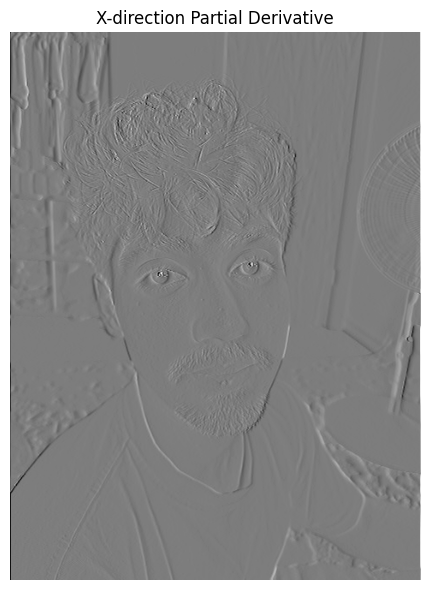

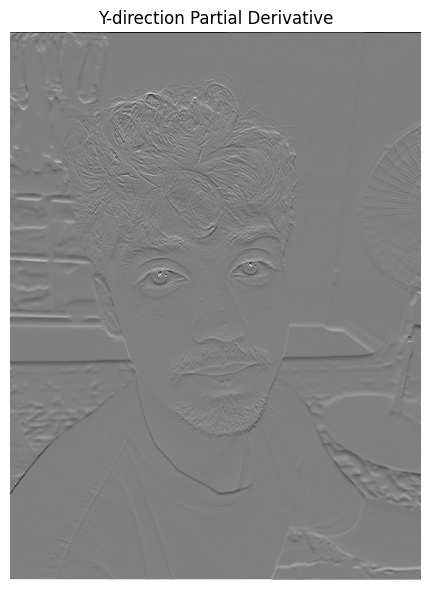

In [51]:
x_direction_diff, y_direction_diff = direction_diff(img)
plt.figure(figsize=(8, 6))
plt.imshow(x_direction_diff, cmap = 'gray')
plt.title('X-direction Partial Derivative')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/05_x_direction_derivative.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8, 6))
plt.imshow(y_direction_diff, cmap = 'gray')
plt.title('Y-direction Partial Derivative')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/06_y_direction_derivative.png', dpi=150, bbox_inches='tight')
plt.show()

In [52]:
def edge_detection(img, threshold):
    x_direction_diff, y_direction_diff = direction_diff(img)
    gradient_magnitude = np.sqrt(x_direction_diff ** 2 + y_direction_diff ** 2)
    edge_image = (gradient_magnitude > threshold).astype(int)
    return edge_image

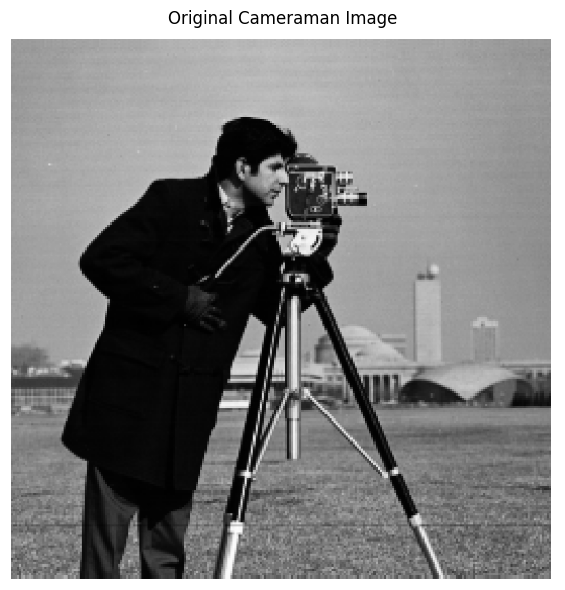

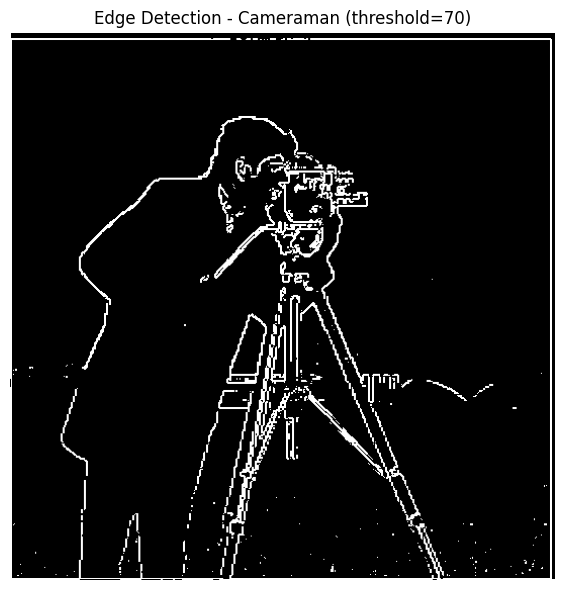

In [82]:
cameraman = Image.open('./images/cameraman.png').convert('L')
cameraman = np.array(cameraman)

# Save original cameraman
plt.figure(figsize=(8, 6))
plt.imshow(cameraman, cmap = 'gray')
plt.title('Original Cameraman Image')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/07_original_cameraman.png', dpi=150, bbox_inches='tight')
plt.show()

edge_img = edge_detection(cameraman, 70)
plt.figure(figsize=(8, 6))
plt.imshow(edge_img, cmap = 'gray')
plt.title('Edge Detection - Cameraman (threshold=70)')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/08_edge_detection_cameraman.png', dpi=150, bbox_inches='tight')
plt.show()

In [54]:
oneD = cv2.getGaussianKernel(3, 1)
gaussian_kernel = oneD * oneD.T
gaussian_kernel


array([[0.07511361, 0.1238414 , 0.07511361],
       [0.1238414 , 0.20417996, 0.1238414 ],
       [0.07511361, 0.1238414 , 0.07511361]])

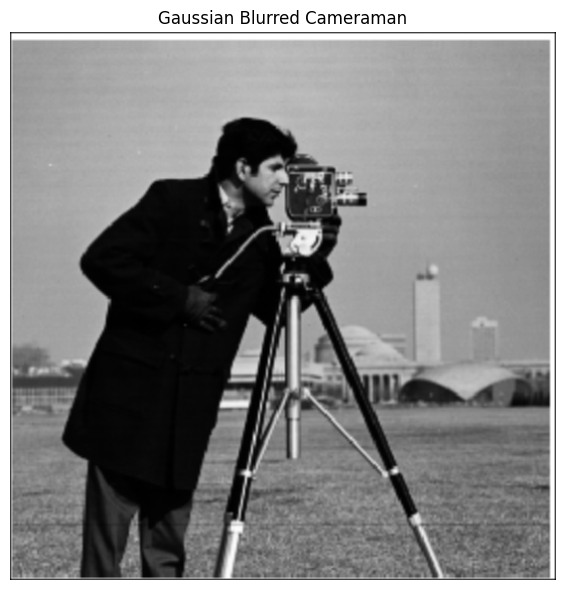

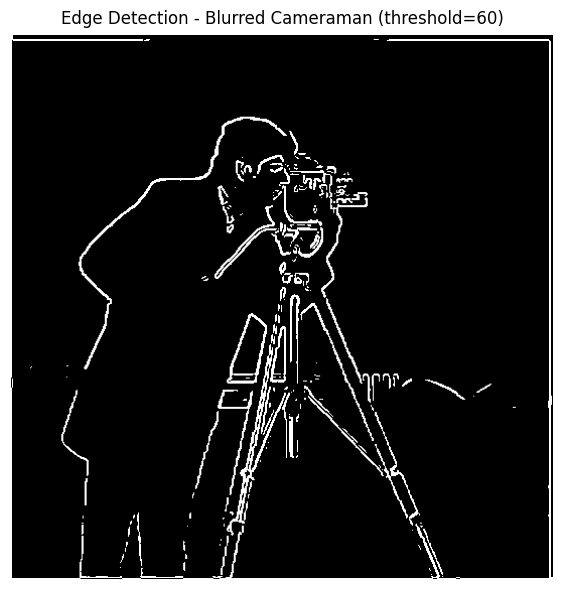

In [55]:
blurred_cameraman = signal.convolve2d(cameraman, gaussian_kernel)
plt.figure(figsize=(8, 6))
plt.imshow(blurred_cameraman, cmap = 'gray')
plt.title('Gaussian Blurred Cameraman')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/09_gaussian_blurred_cameraman.png', dpi=150, bbox_inches='tight')
plt.show()

cameraman_edges = edge_detection(blurred_cameraman, 60)
plt.figure(figsize=(8, 6))
plt.imshow(cameraman_edges, cmap = 'gray')
plt.title('Edge Detection - Blurred Cameraman (threshold=60)')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/10_edge_detection_blurred_cameraman.png', dpi=150, bbox_inches='tight')
plt.show()


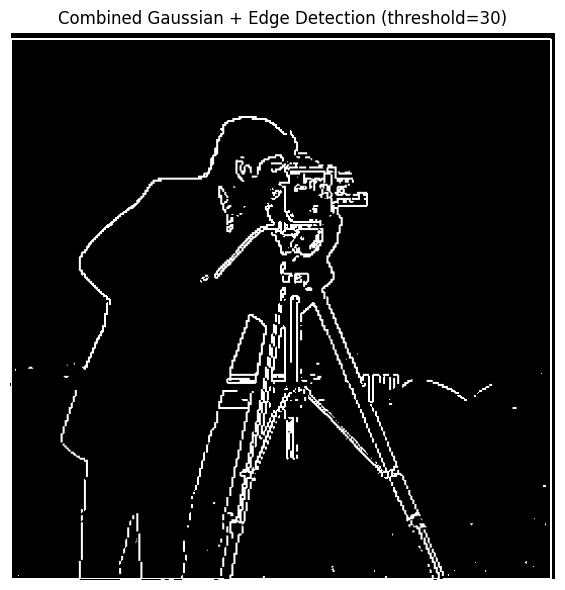

In [56]:
def combined_edge_detection(img, threshold, kernel, dx, dy):
    combined_dx = signal.convolve2d(kernel, dx, mode = 'same')
    combined_dy = signal.convolve2d(kernel, dy, mode = 'same')
    gradient_magnitude_x = signal.convolve2d(img, combined_dx, mode = 'same')
    gradient_magnitude_y = signal.convolve2d(img, combined_dy, mode = 'same')
    gradient_magnitude = np.sqrt(gradient_magnitude_x ** 2 + gradient_magnitude_y ** 2)
    edge_image = (gradient_magnitude > threshold).astype(int)
    return edge_image

dx = np.array([[1, 0, -1]])
dy = np.array([[1], [0], [-1]])
combined_edge_cameraman = combined_edge_detection(cameraman, 30, gaussian_kernel, dx, dy)
plt.figure(figsize=(8, 6))
plt.imshow(combined_edge_cameraman, cmap = 'gray')
plt.title('Combined Gaussian + Edge Detection (threshold=30)')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/11_combined_edge_detection.png', dpi=150, bbox_inches='tight')
plt.show()

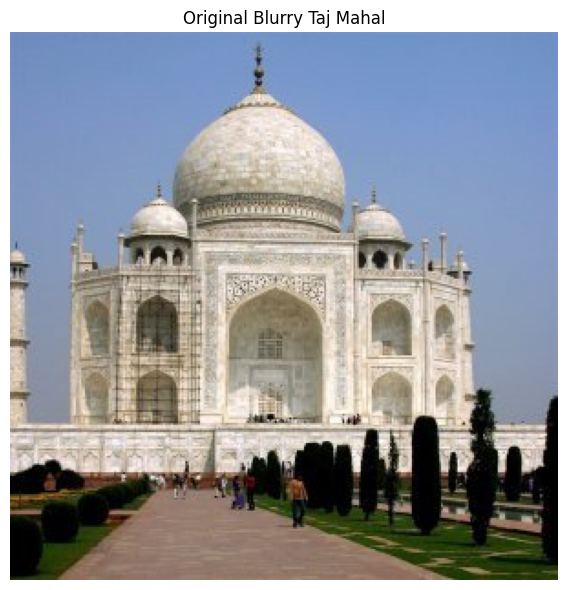

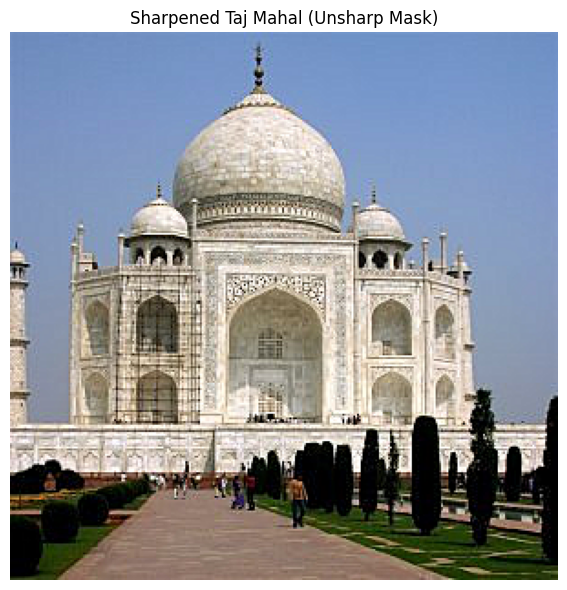

In [ ]:
taj = Image.open('./images/taj_blurry.jpg')
taj = np.array(taj)

def sharpen_img(img, kernel_size, alpha):
    # without making float first, uint8 - overflow and give odd colors if out of bounds
    img = img.astype(np.float32)

    blurred_img = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    diff = img - blurred_img

    sharpened_img = img + (alpha * diff)
    sharpened = np.clip(sharpened_img, 0, 255).astype(np.uint8)
    return sharpened

sharp_taj = sharpen_img(taj, 5, 1)

plt.figure(figsize=(10, 6))
plt.imshow(taj)
plt.title('Original Blurry Taj Mahal')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/12_original_blurry_taj.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(10, 6))
plt.imshow(sharp_taj)
plt.title('Sharpened Taj Mahal (Unsharp Mask)')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/13_sharpened_taj.png', dpi=150, bbox_inches='tight')
plt.show()

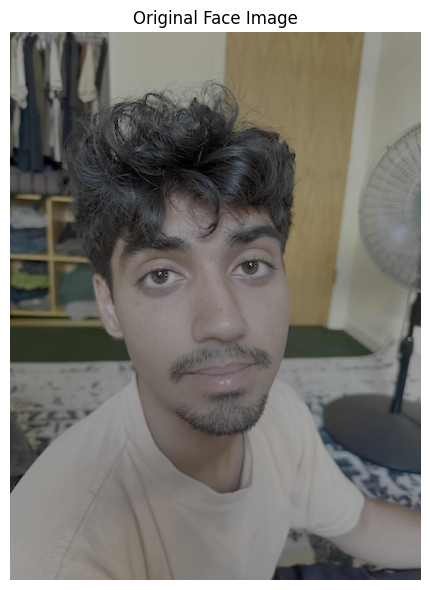

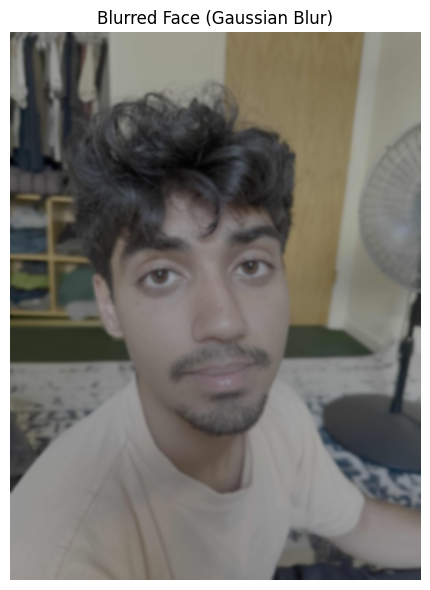

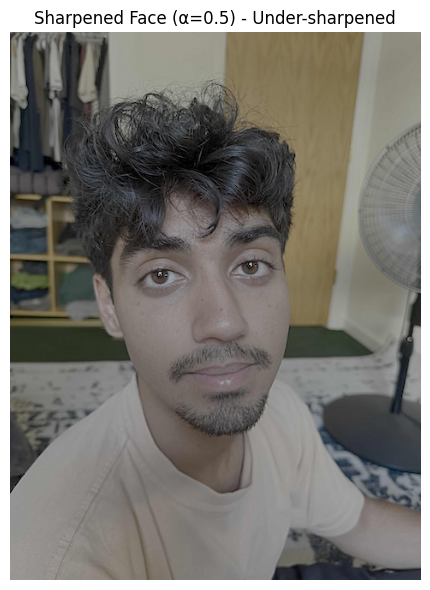

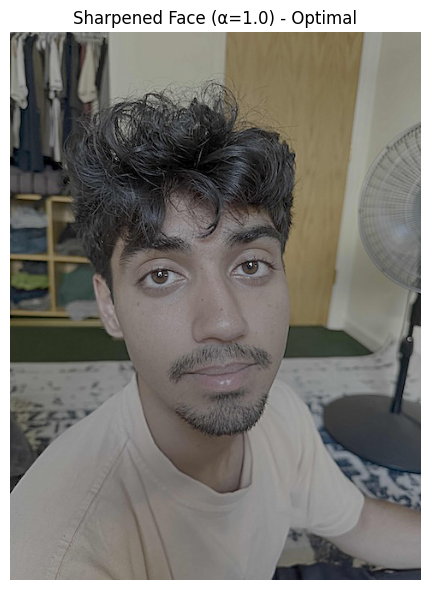

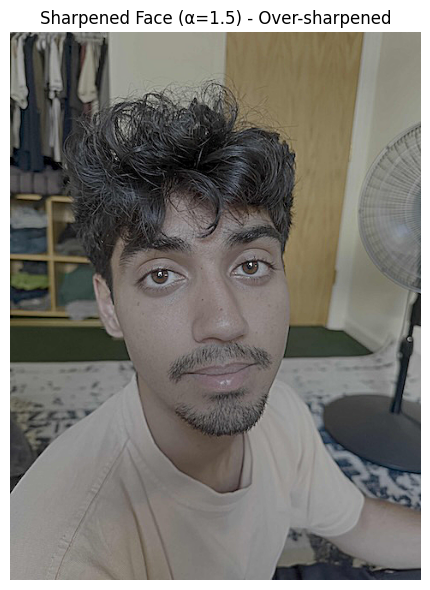

In [ ]:
# testing sharpening with face
face = Image.open('./images/convolution_img.jpeg')
face = np.array(face)

blurred_face = cv2.GaussianBlur(face, (7, 7), 0)

sharp_face = sharpen_img(face, 7, 1)
sharp_face_05 = sharpen_img(face, 7, 0.5)
sharp_face_15 = sharpen_img(face, 7, 1.5)

plt.figure(figsize=(8, 6))
plt.imshow(face)
plt.title('Original Face Image')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/14_original_face.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8, 6))
plt.imshow(blurred_face)
plt.title('Blurred Face (Gaussian Blur)')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/15_blurred_face.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8, 6))
plt.imshow(sharp_face_05)
plt.title('Sharpened Face (α=0.5) - Under-sharpened')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/16_sharpened_face_05.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8, 6))
plt.imshow(sharp_face)
plt.title('Sharpened Face (α=1.0) - Optimal')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/17_sharpened_face_10.png', dpi=150, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8, 6))
plt.imshow(sharp_face_15)
plt.title('Sharpened Face (α=1.5) - Over-sharpened')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/18_sharpened_face_15.png', dpi=150, bbox_inches='tight')
plt.show()


In [59]:
def color_to_gray(img):
    img = img.astype(np.uint8)
    tobgr = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    temp = cv2.cvtColor(tobgr, cv2.COLOR_BGR2GRAY)
    return temp

In [60]:
def log_fourier(img):
    fft_img = np.fft.fft2(img)
    shift = np.fft.fftshift(fft_img)
    log_fft = np.log(np.abs(shift))
    return log_fft

In [ ]:
def hybrid_img(img1, img2, blur_ksize, sharpen_ksize, save_prefix):
    if img1.dtype != np.uint8:
        img1 = (img1.astype(np.float32) * 255).astype(np.uint8)
    if img2.dtype != np.uint8:
        img2 = (img2.astype(np.float32) * 255).astype(np.uint8)

    img1 = color_to_gray(img1)
    img2 = color_to_gray(img2)
    
    pre_filter1 = log_fourier(img1)
    pre_filter2 = log_fourier(img2)

    img1 = img1.astype(np.float32)
    img2 = img2.astype(np.float32)

    # blur img2
    img2_blur = cv2.GaussianBlur(img2, (blur_ksize, blur_ksize), 0)

    # sharpen img2
    img1_sharp = sharpen_img(img1, sharpen_ksize, 1)

    # blend the images
    hybrid = img2_blur + img1_sharp

    hybrid = np.clip(hybrid, 0, 255).astype(np.uint8)
    img2_blur = img2_blur.astype(np.uint8)
    img1_sharp = img1_sharp.astype(np.uint8)

    hybrid_fourier = log_fourier(hybrid)
    post_filter1 = log_fourier(img2_blur)
    post_filter2 = log_fourier(img1_sharp)

    plt.figure(figsize=(8, 6))
    plt.imshow(hybrid, cmap = 'gray')
    plt.title('Hybrid Image')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/{save_prefix}_hybrid.png', dpi=150, bbox_inches='tight')
    plt.show()

    plt.figure(figsize=(8, 6))
    plt.imshow(hybrid_fourier, cmap = 'gray')
    plt.title('Hybrid Fourier Transform')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/{save_prefix}_hybrid_fourier.png', dpi=150, bbox_inches='tight')
    plt.show()

    plt.figure(figsize=(8, 6))
    plt.imshow(post_filter1, cmap = 'gray')
    plt.title('Post Filter - Blurred Image')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/{save_prefix}_post_filter_blur.png', dpi=150, bbox_inches='tight')
    plt.show()

    plt.figure(figsize=(8, 6))
    plt.imshow(post_filter2, cmap = 'gray')
    plt.title('Post Filter - Sharpened Image')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/{save_prefix}_post_filter_sharp.png', dpi=150, bbox_inches='tight')
    plt.show()

    plt.figure(figsize=(8, 6))
    plt.imshow(pre_filter1, cmap = 'gray')
    plt.title('Pre Filter - Image 1')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/{save_prefix}_pre_filter1.png', dpi=150, bbox_inches='tight')
    plt.show()

    plt.figure(figsize=(8, 6))
    plt.imshow(pre_filter2, cmap = 'gray')
    plt.title('Pre Filter - Image 2')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/{save_prefix}_pre_filter2.png', dpi=150, bbox_inches='tight')
    plt.show()

In [62]:
import sys
hybrid_path = './images/hybrid_python/'
sys.path.append(hybrid_path)

from align_image_code import align_images

In [ ]:
# for interactive plots
%matplotlib qt

cat = Image.open('./images/hybrid_python/nutmeg.jpg')
cat = np.array(cat)

derek = Image.open('./images/hybrid_python/DerekPicture.jpg')
derek = np.array(derek)

aligned_cat, aligned_derek = align_images(cat, derek)

%matplotlib inline

Please select 2 points in each image for alignment.


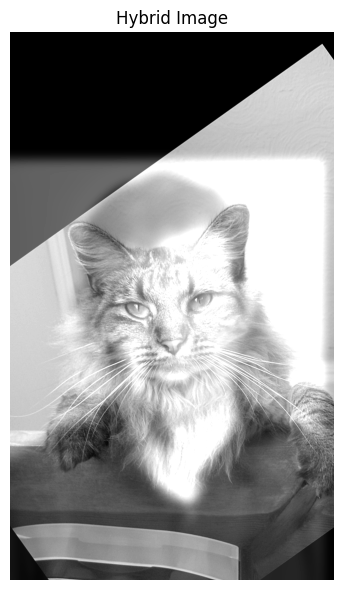

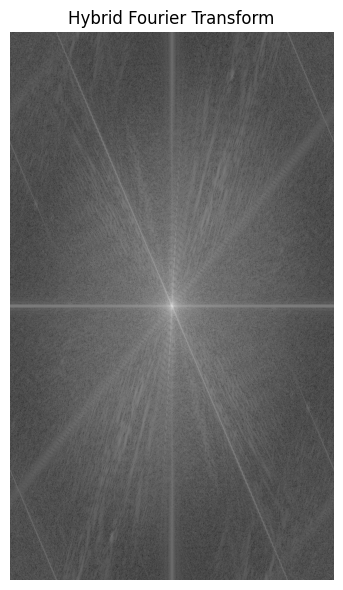

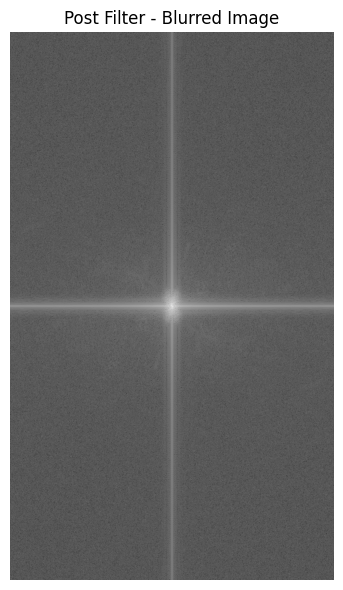

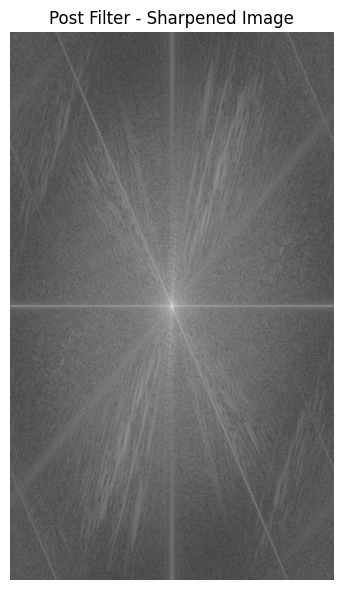

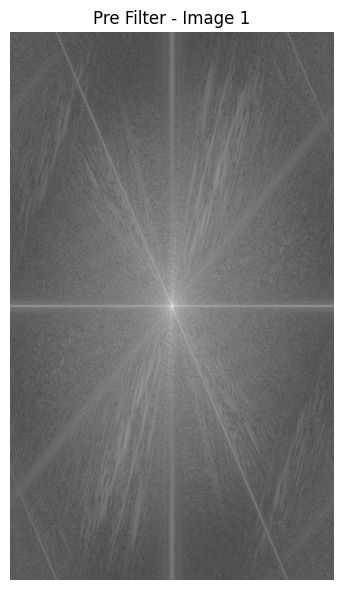

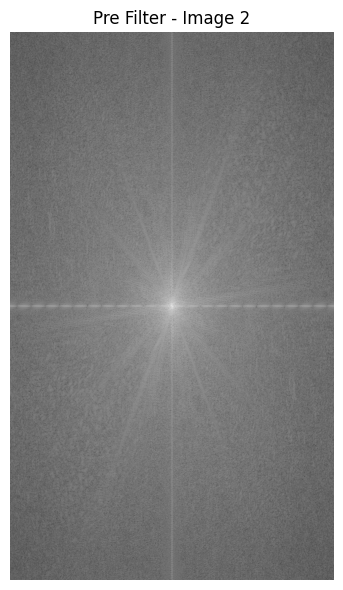

In [64]:
hybrid_img(aligned_cat, aligned_derek, 75, 5, "17_derek_nutmeg")

In [65]:
lincoln = Image.open('./images/lincoln.jpg')
lincoln = np.array(lincoln)

obama = Image.open('./images/obama.jpg')
obama = np.array(obama)

%matplotlib qt
aligned_obama, aligned_lincoln = align_images(obama, lincoln)
%matplotlib inline


Please select 2 points in each image for alignment.


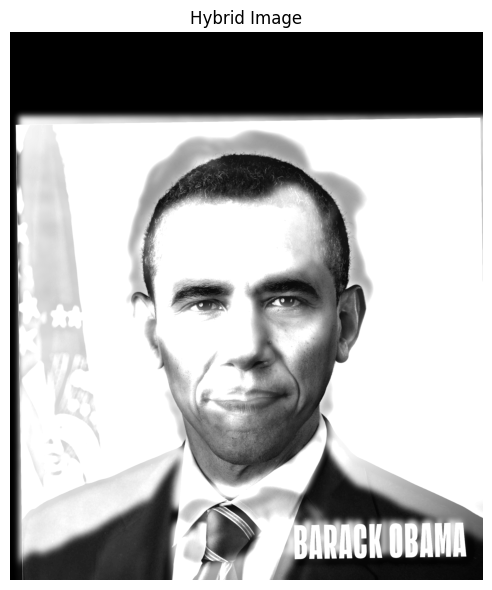

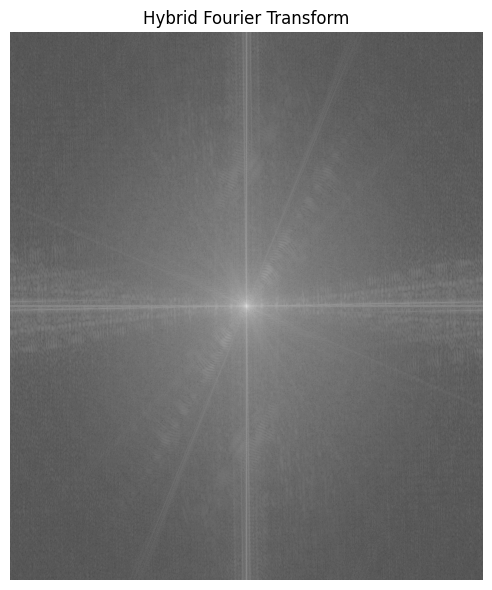

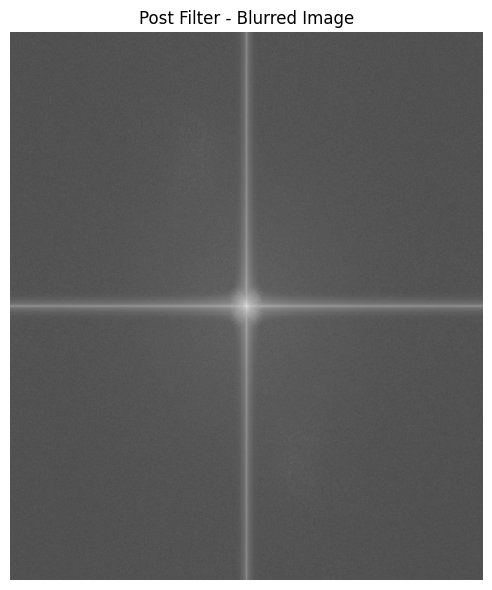

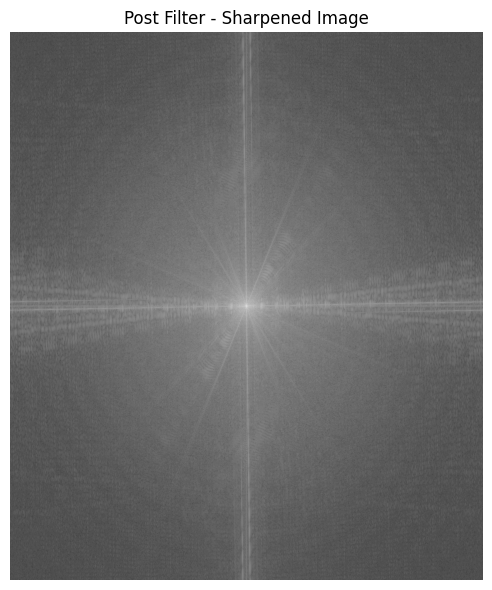

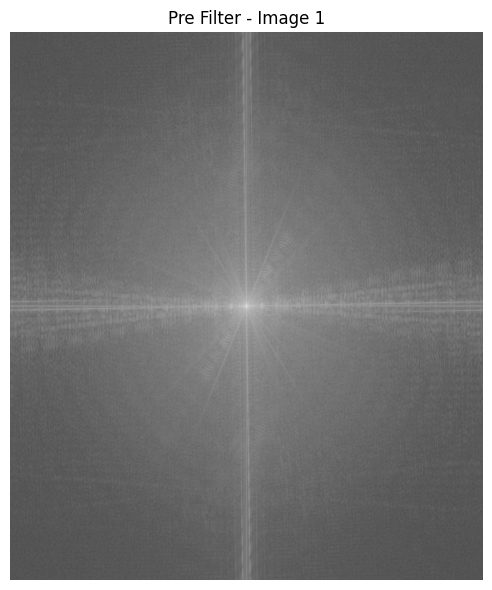

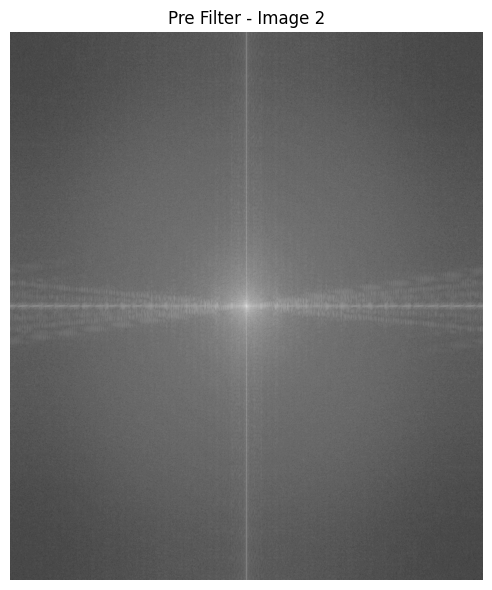

In [66]:
aligned_obama_bright = aligned_obama.astype(np.float32) * 0.75
aligned_lincoln_bright = aligned_lincoln.astype(np.float32) * 1

hybrid_img(aligned_obama_bright, aligned_lincoln_bright, 75, 125, "18_obama_lincoln")

In [67]:
lion = Image.open('./images/lion.jpeg')
lion = np.array(lion)

tiger = Image.open('./images/tiger.jpeg')
tiger = np.array(tiger)

%matplotlib qt
aligned_tiger, aligned_lion = align_images(tiger, lion)
%matplotlib inline


Please select 2 points in each image for alignment.


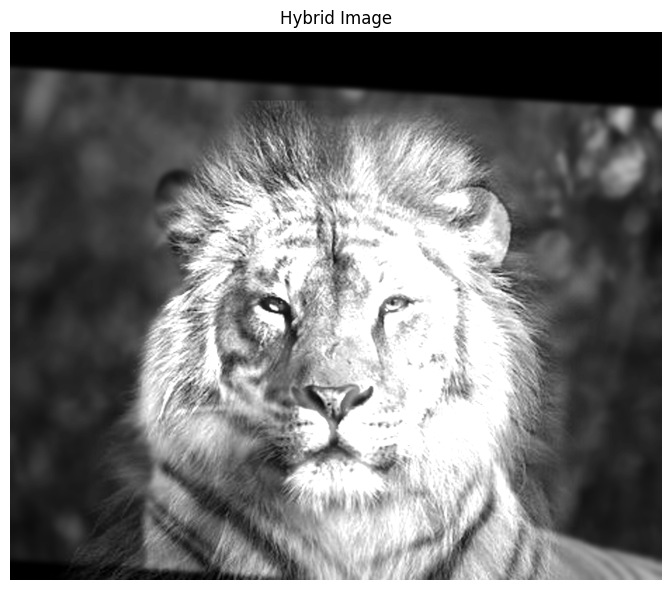

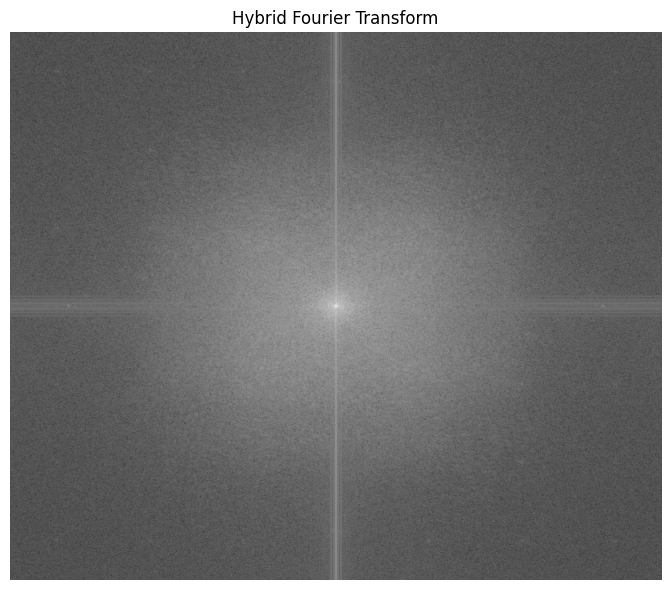

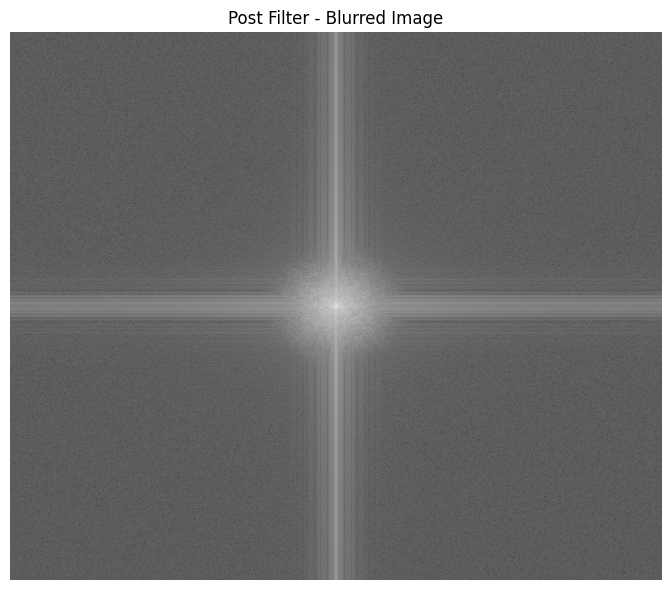

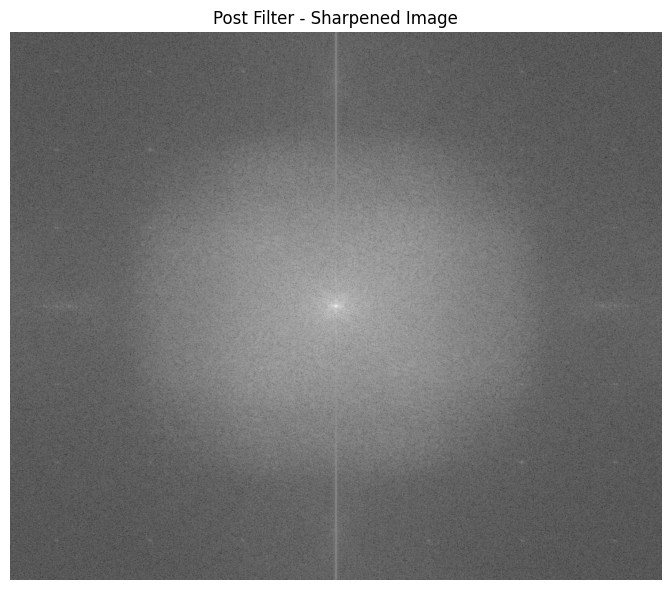

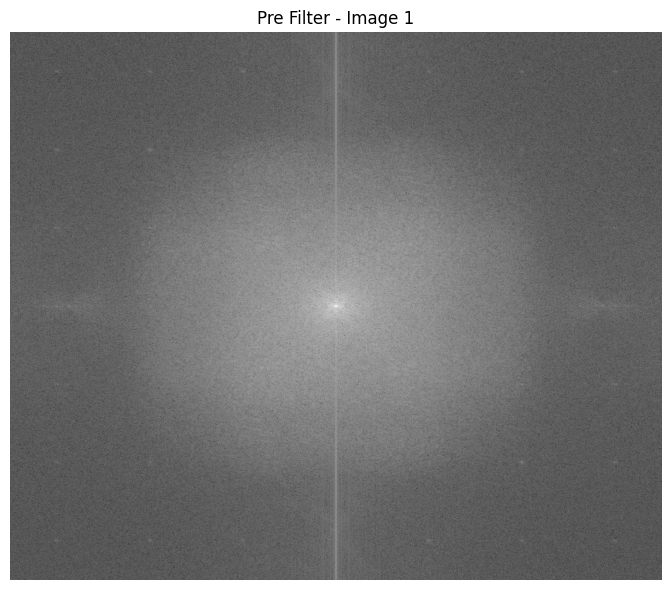

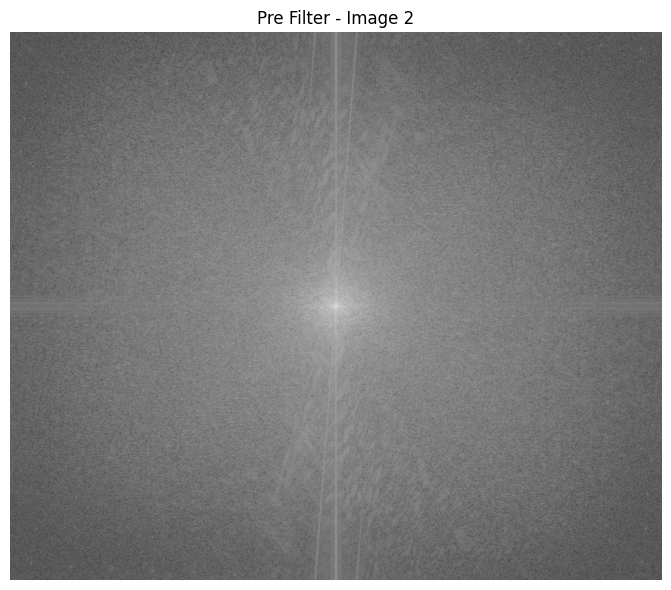

In [68]:
hybrid_img(aligned_lion, aligned_tiger, 25, 25, "19_lion_tiger")


In [69]:
def gaussian_stack(img, ksize, levels):
    stack = [img]
    for i in range(1, levels):
        last = stack[-1]
        blurred = cv2.GaussianBlur(last, (ksize, ksize), 0)
        stack.append(blurred.astype(np.float32))
    return stack

def laplacian_stack(img, ksize, levels):
    g_stack = gaussian_stack(img, ksize, levels)
    l_stack = []
    for i in range(len(g_stack) - 1):
        diff = g_stack[i] - g_stack[i + 1]
        l_stack.append(diff.astype(np.float32))
    l_stack.append(g_stack[-1])
    return l_stack, g_stack


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


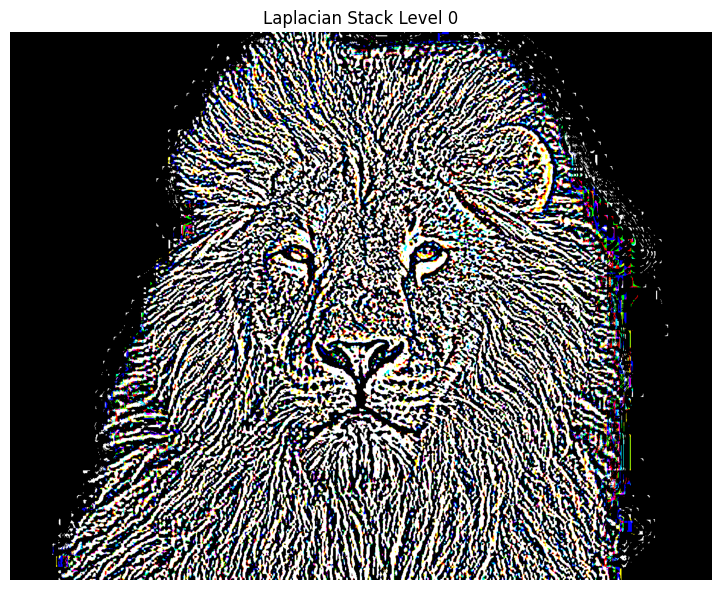

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


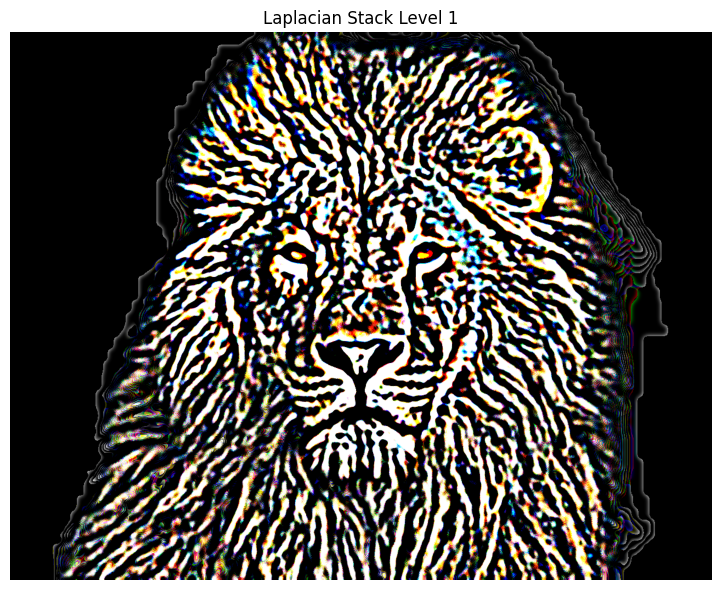

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


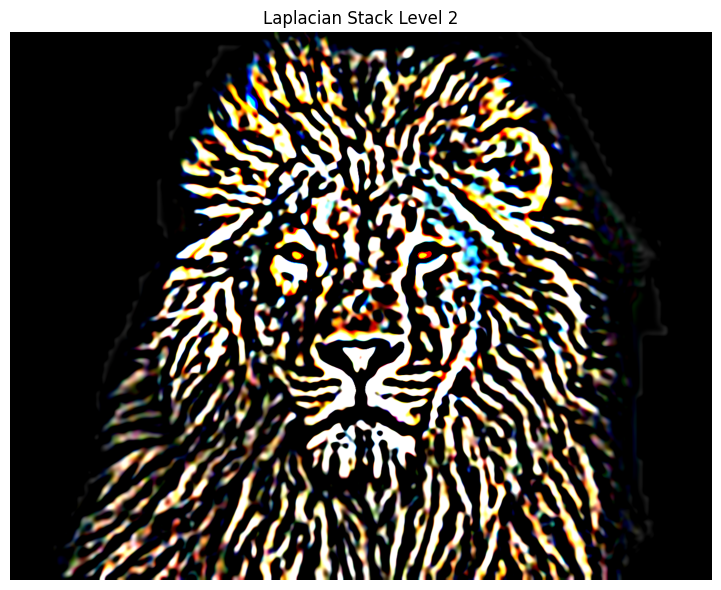

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


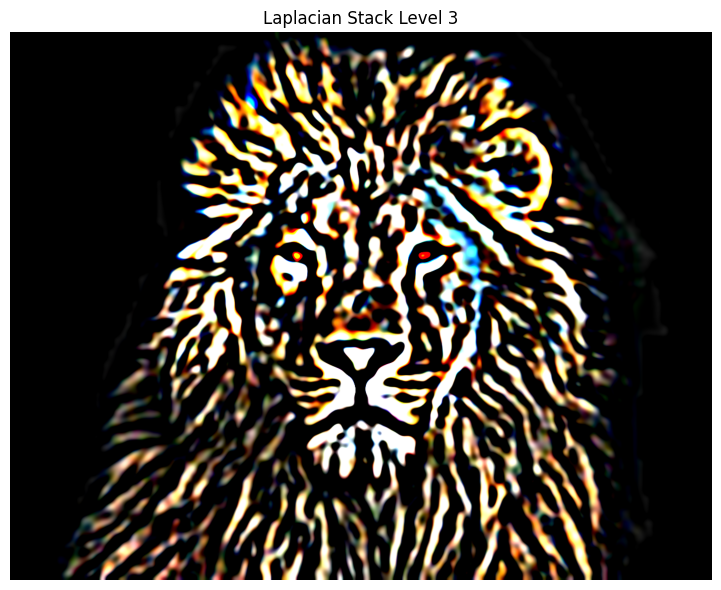

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


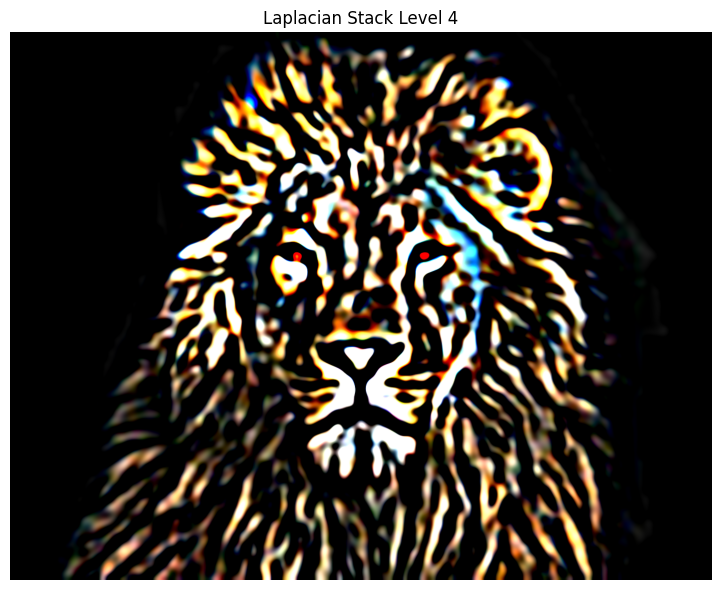

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


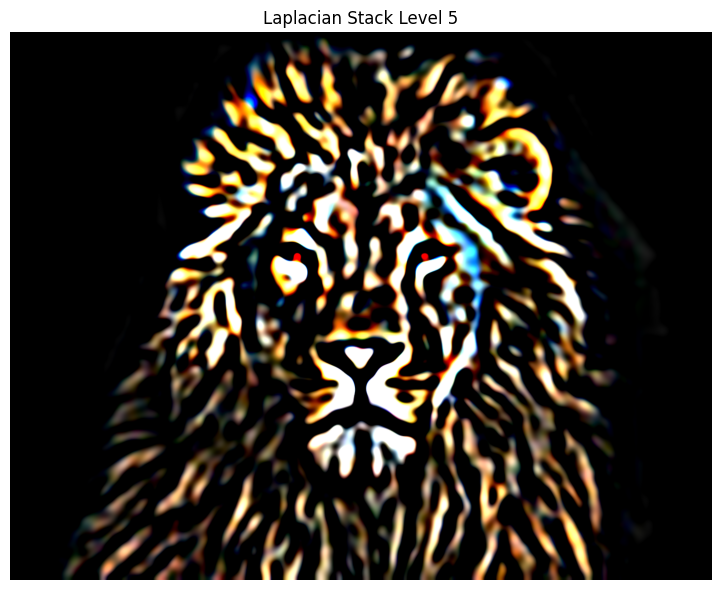

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


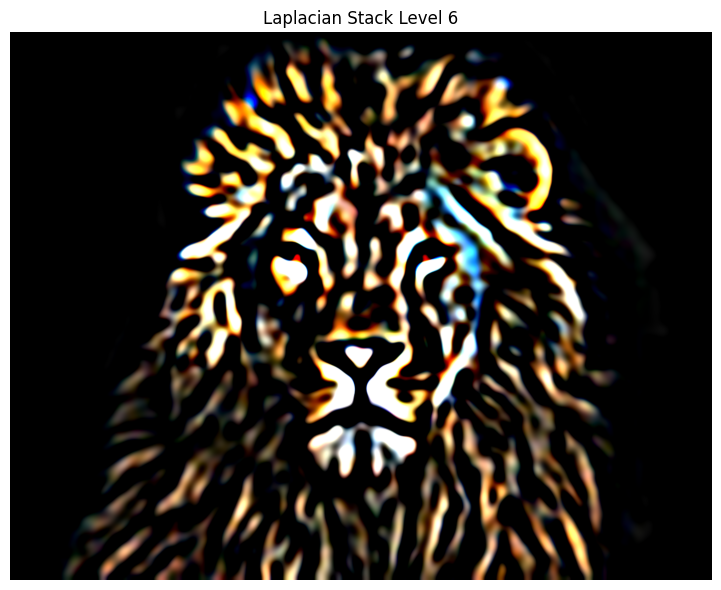

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


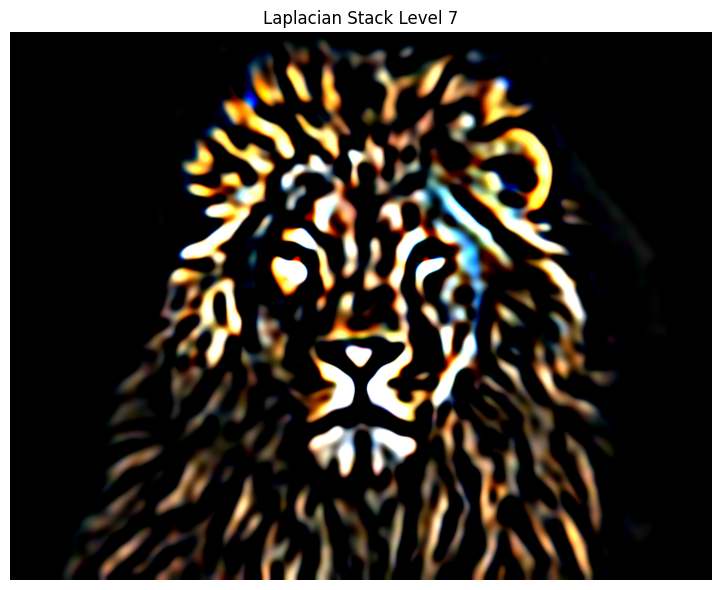

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


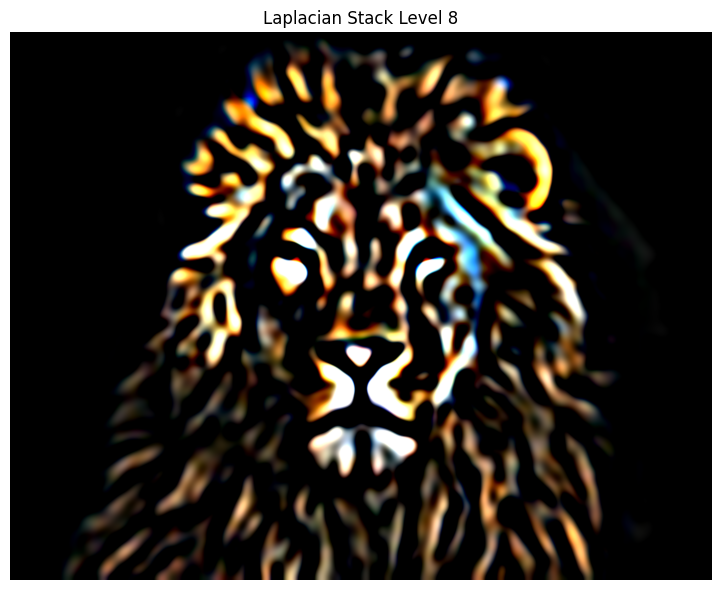

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


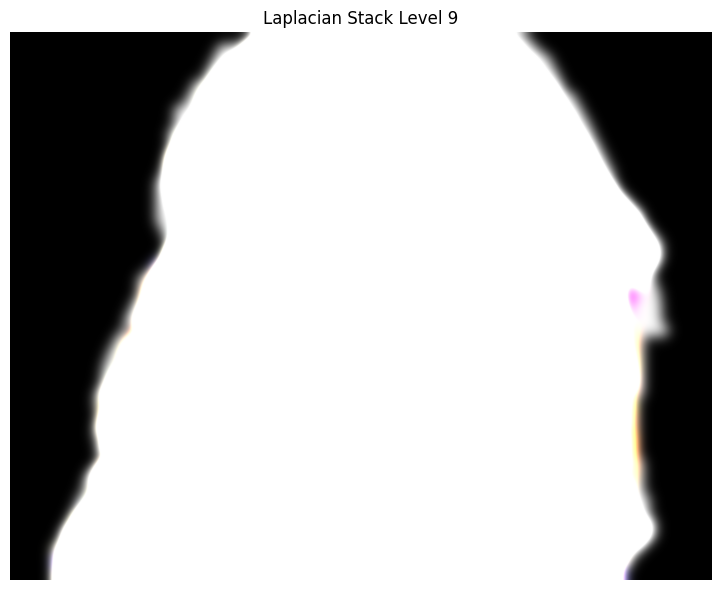

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


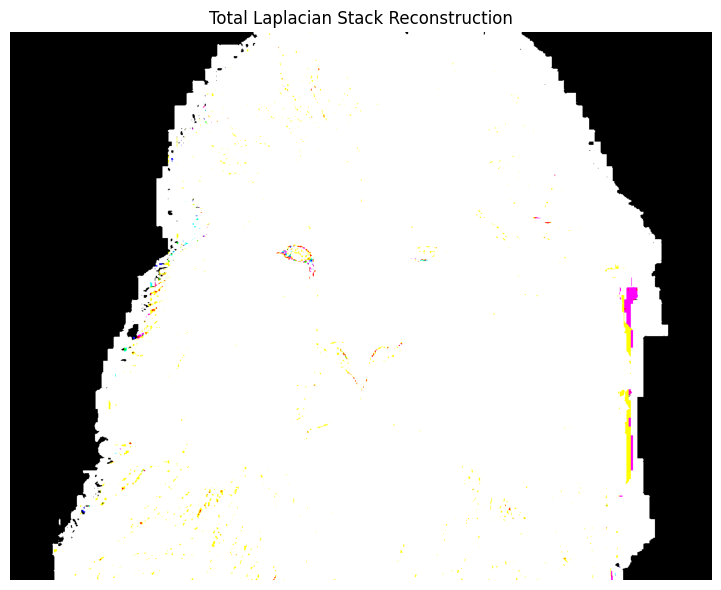

In [70]:
laplacian_lion, _ = laplacian_stack(lion, 25, 10)

for i in range(len(laplacian_lion)):
    plt.figure(figsize=(8, 6))
    plt.imshow(laplacian_lion[i], cmap = 'gray')
    plt.title(f'Laplacian Stack Level {i}')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./processed_images/20_laplacian_level_{i}.png', dpi=150, bbox_inches='tight')
    plt.show()

total = sum(laplacian_lion)

plt.figure(figsize=(8, 6))
plt.imshow(total, cmap = 'gray')
plt.title('Total Laplacian Stack Reconstruction')
plt.axis('off')
plt.tight_layout()
plt.savefig('./processed_images/21_total_laplacian_reconstruction.png', dpi=150, bbox_inches='tight')
plt.show()

In [71]:
apple = Image.open('./images/spline/apple.jpeg')
apple = np.array(apple)

orange = Image.open('./images/spline/orange.jpeg')
orange = np.array(orange)

In [72]:
def vertical_mask(img, percent, ksize, levels):
    #img will be left % of the mask
    h, w, c = img.shape
    mask = np.zeros((h, w, c), dtype = np.float32)
    mask[:, :int(w * (percent / 100)), :] = 1.0

    g_mask = gaussian_stack(mask, ksize, levels)
    return g_mask

def irregular_mask(mask, ksize, levels):
    g_mask = gaussian_stack(mask, ksize, levels)
    return g_mask

def blended_img(img1, img2, ksize, levels, percent, mask_ksize, mask = False, save_prefix = None):
    l_img1, g_img1 = laplacian_stack(img1, ksize, levels)
    l_img2, g_img2 = laplacian_stack(img2, ksize, levels)

    if mask is not False:
        mask_stack = irregular_mask(mask, mask_ksize, levels)
    else:
        mask_stack = vertical_mask(img1, percent, mask_ksize, levels)

    blended_stack = []

    for i in range(len(l_img1)):
        blended = l_img1[i] * mask_stack[i] + l_img2[i] * (1 - mask_stack[i])
        blended_stack.append(blended)
    
    blended_img = np.clip(sum(blended_stack), 0, 255).astype(np.uint8)
    print(blended_stack[0].shape)

    if save_prefix:
        plt.figure(figsize=(10, 6))
        plt.imshow(blended_img)
        plt.title('Multi-Scale Blended Image')
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(f'./processed_images/{save_prefix}_blended.png', dpi=150, bbox_inches='tight')
        plt.show()

    return blended_img

(300, 300, 3)


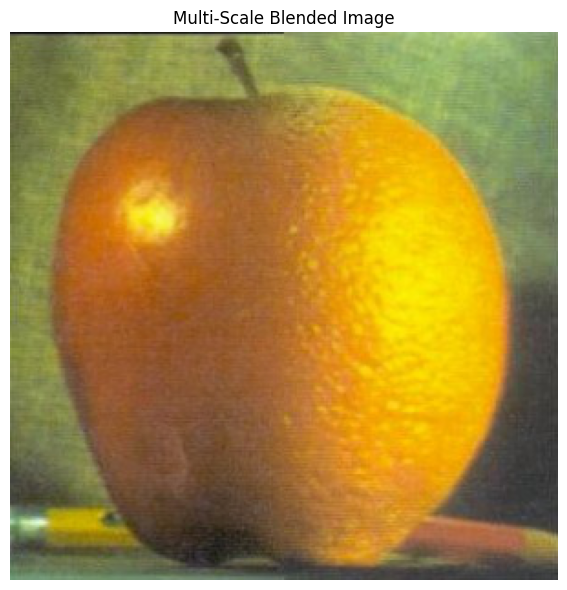

In [73]:
oraple = blended_img(apple, orange, 7, 10, 50, 75, save_prefix="22_apple_orange")


(320, 320, 3)


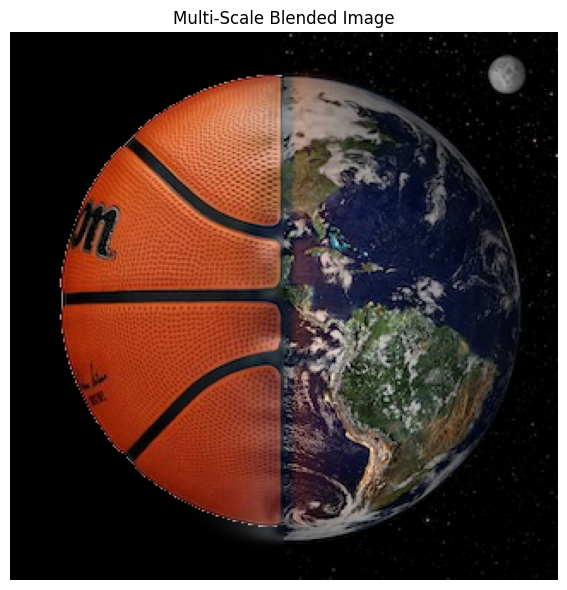

In [74]:
basketball = Image.open('./images/spline/basketball.jpg')
basketball = np.array(basketball)

mask = np.all(basketball >= [150, 150, 150], axis=-1)
basketball[mask] = [0, 0, 0]


earth = Image.open('./images/spline/earth.jpeg')
earth = np.array(earth)

basketearth = blended_img(basketball, earth, 7, 10, 50, 55, save_prefix="23_basketball_earth")


(213, 320, 3)


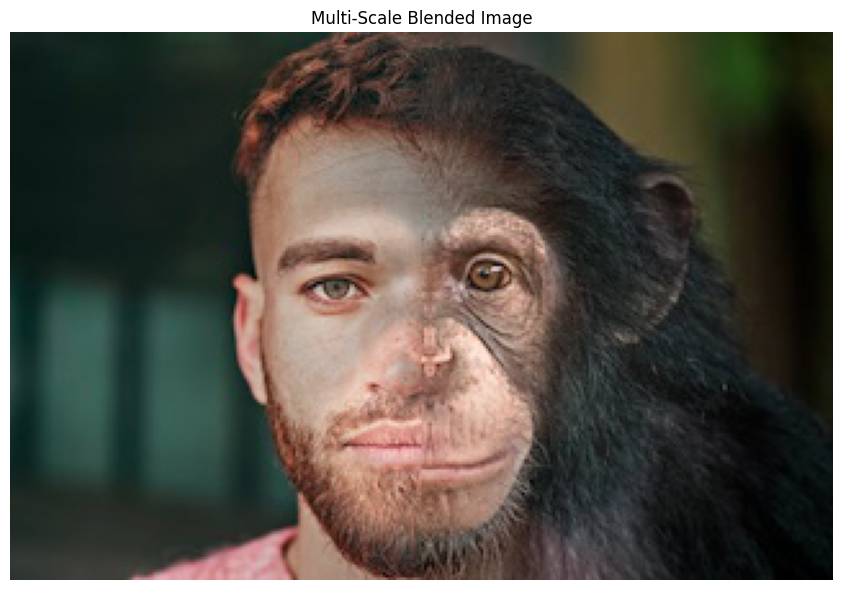

In [75]:
human = Image.open('./images/spline/human.jpeg')
human = np.array(human)

monkey = Image.open('./images/spline/monkey.jpeg')
monkey = np.array(monkey)
monkey = monkey[10:-11, :, :]

humanmonkey = blended_img(human, monkey, 7, 20, 50, 95, save_prefix="24_human_monkey")



In [ ]:
def create_polygon_mask(img):
    """
    Lets user draw a polygon on the given image. Will be overlayed on img2
    Returns a mask (H x W x 3) of float32 values (1s inside polygon, 0s outside).
    Controls:
    Left-click: add points on mouse click
    Right-click: close polygon by connecting all points
    S: save mask - minimum 3 points
    ESC: exit without mask
    """
    points = []
    mask = np.zeros(img.shape, dtype=np.float32)
    img_display = img.copy()

    def click_event(event, x, y, flags, param):
        nonlocal points, mask, img_display

        if event == cv2.EVENT_LBUTTONDOWN:
            points.append((x, y))
            cv2.circle(img_display, (x, y), 3, (0, 0, 255), -1)  # draw red dot on mouse click
            cv2.imshow("Draw Polygon", img_display)

        elif event == cv2.EVENT_RBUTTONDOWN:
            if len(points) > 2:
                pts = np.array(points, np.int32).reshape((-1, 1, 2))
                cv2.fillPoly(mask, [pts], (1, 1, 1))  # fill with 1s
                cv2.polylines(img_display, [pts], isClosed=True, color=(0, 255, 0), thickness=2)
                cv2.imshow("Draw Polygon", img_display)

    cv2.namedWindow("Draw Polygon")
    cv2.setMouseCallback("Draw Polygon", click_event)

    print("Instructions: Left-click to add points, Right-click to close polygon, S to save after 3 points, ESC to exit")

    while True:
        cv2.imshow("Draw Polygon", img_display)
        key = cv2.waitKey(1) & 0xFF
        if key == 27:  # ESC exits without saving 
            print("Exiting without saving mask.")
            break
        elif key == ord('s'):  # Save and return mask
            cv2.destroyAllWindows()
            return mask

    cv2.destroyAllWindows()
    return mask  # may be empty if ESC pressed


In [ ]:
def irregular_blend(img1, img2, ksize, levels, percent, mask_ksize, save_prefix):
    # mask is made from img1
    mask = create_polygon_mask(img1)
    # blend img1 and img2 using the mask
    blended = blended_img(img1, img2, ksize, levels, percent, mask_ksize, mask, save_prefix)
    return blended

Instructions: Left-click to add points, Right-click to close polygon, S to save after 3 points, ESC to exit
(320, 320, 3)


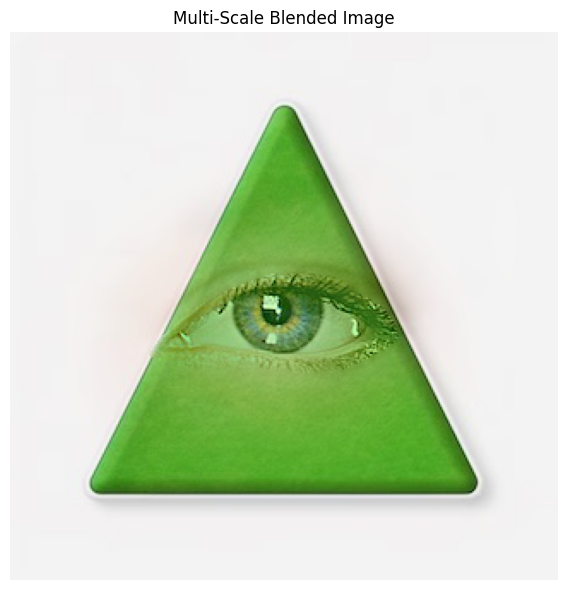

In [78]:
eye = Image.open('./images/spline/eye.jpg')
eye = np.array(eye)

triangle = Image.open('./images/spline/triangle.jpg')
triangle = np.array(triangle)

illuminati = irregular_blend(eye, triangle, 7, 10, 50, 75, "25_eye_triangle")

Instructions: Left-click to add points, Right-click to close polygon, S to save after 3 points, ESC to exit
(320, 320, 3)


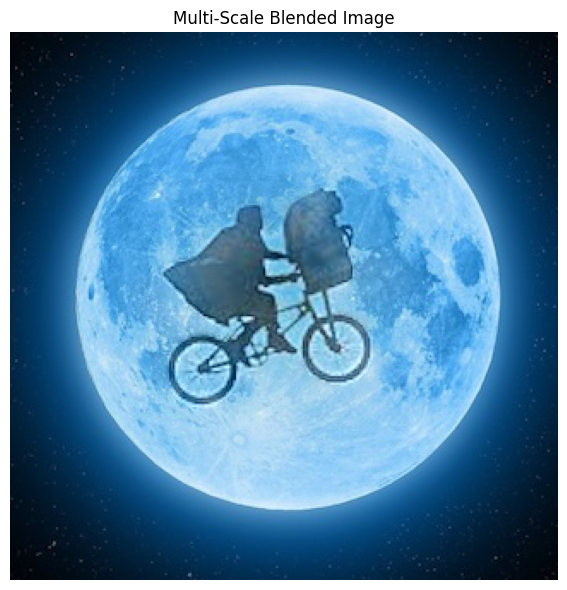

In [79]:
et = Image.open('./images/spline/ET.jpeg')
et = np.array(et)

moon = Image.open('./images/spline/moon.jpeg')
moon = np.array(moon)

ET_moon = irregular_blend(et, moon, 7, 10, 50, 75, "26_ET_moon")

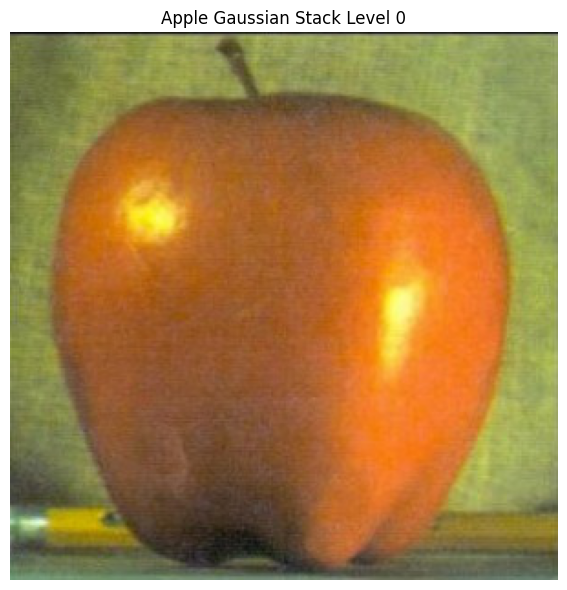

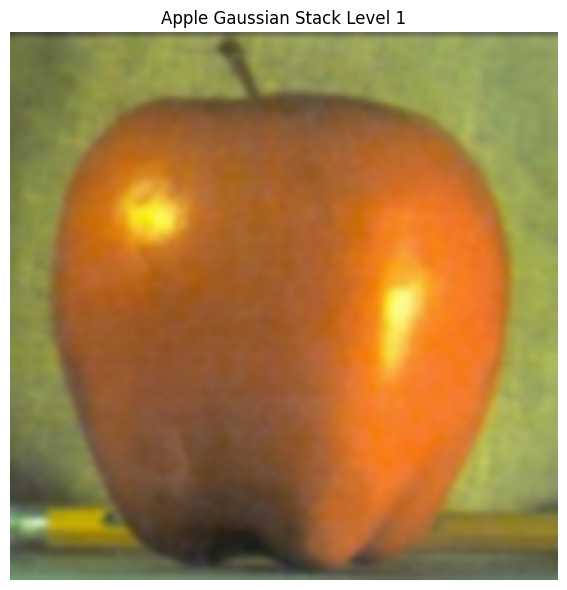

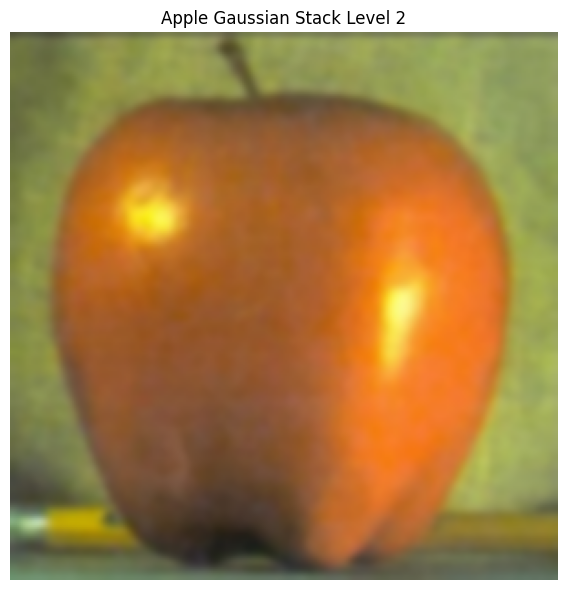

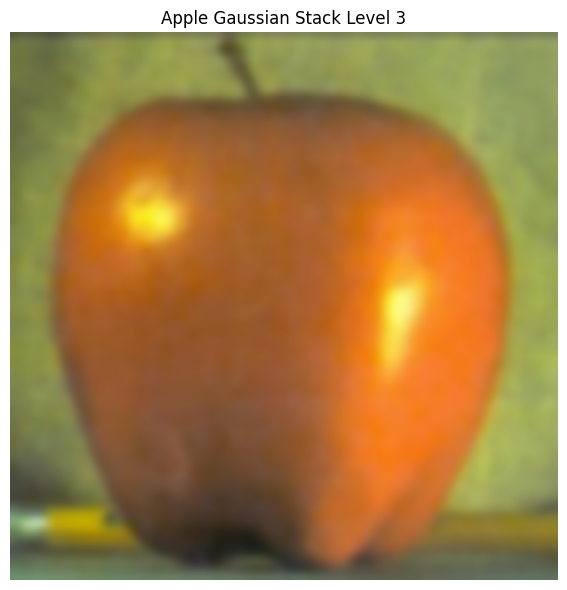

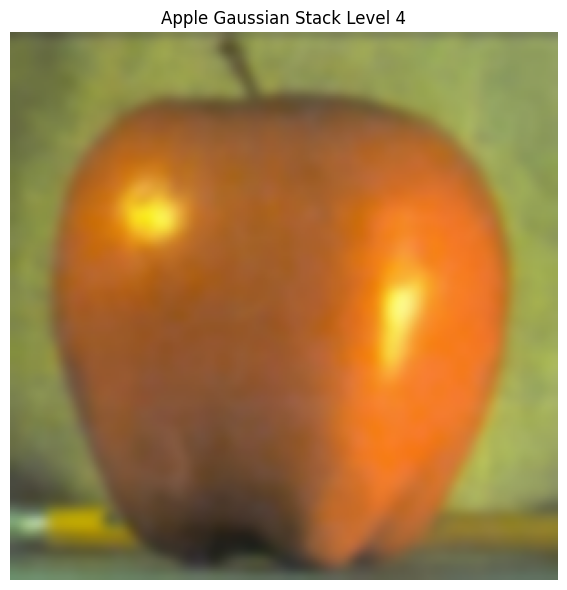

...

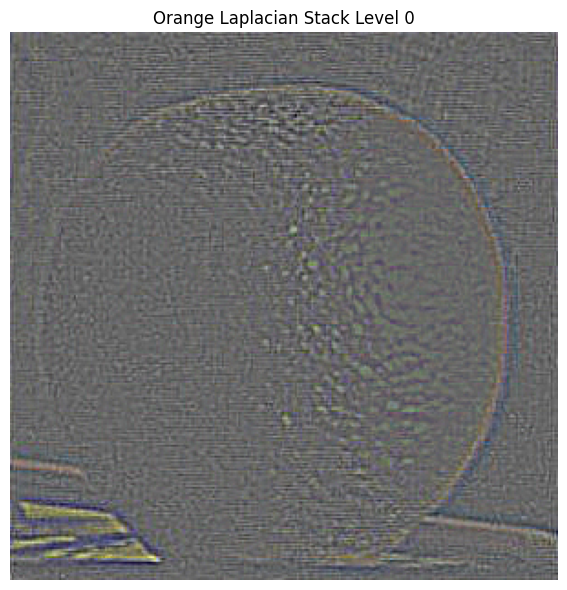

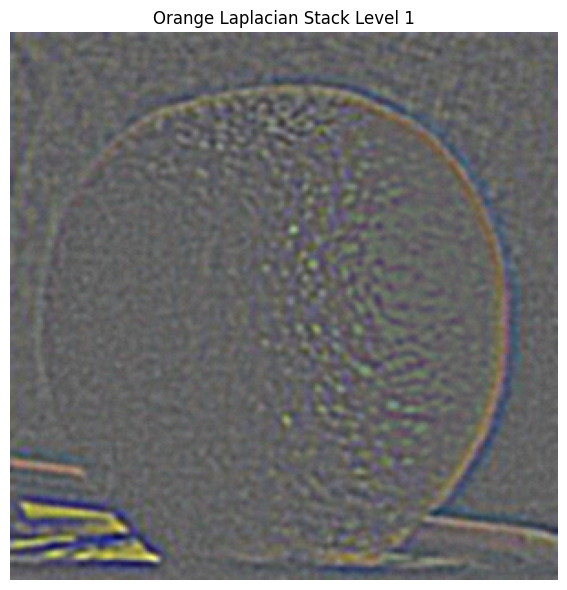

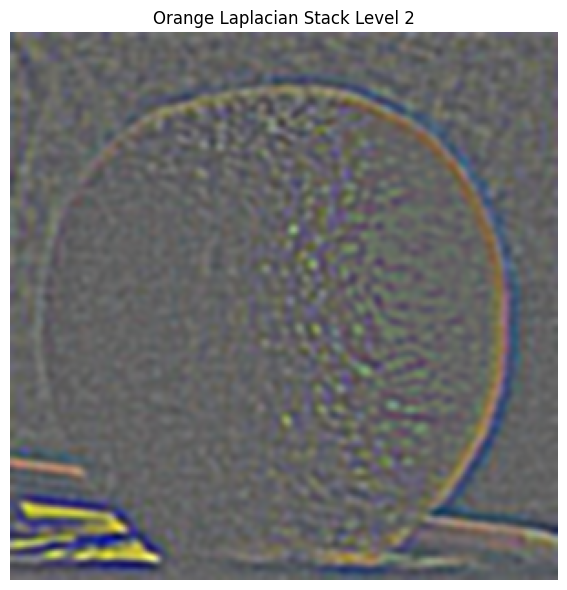

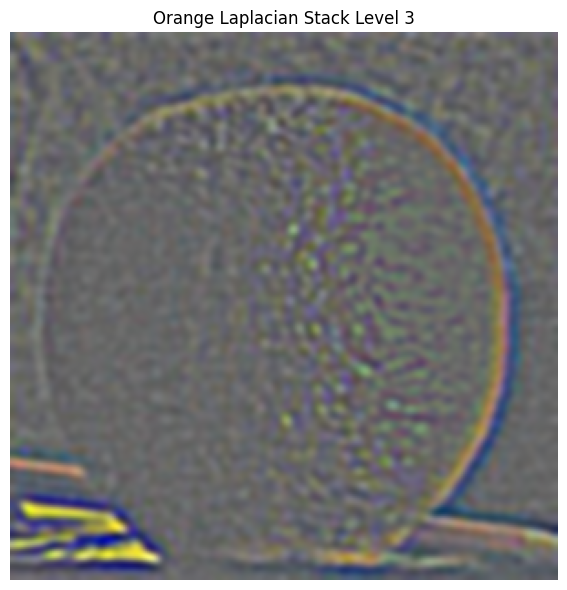

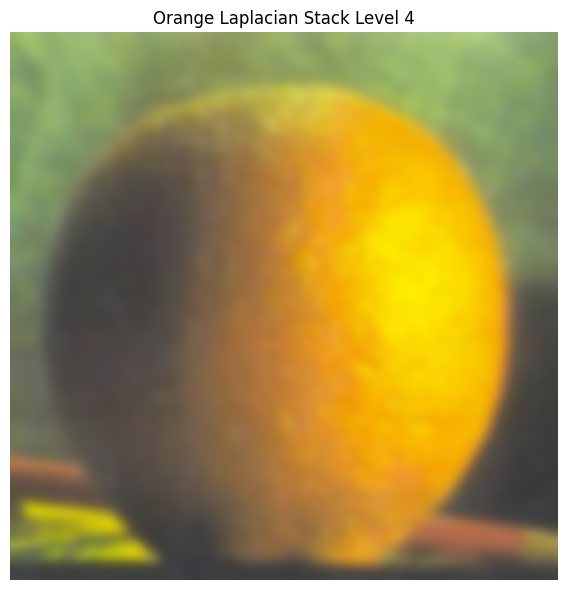

In [ ]:

apple = Image.open('./images/spline/apple.jpeg')
apple = np.array(apple)

orange = Image.open('./images/spline/orange.jpeg')
orange = np.array(orange)

# gaussian stacks (level 4)
apple_gaussian_stack = gaussian_stack(apple, 7, 5) 
orange_gaussian_stack = gaussian_stack(orange, 7, 5)

# laplacian stacks (level 4)
apple_laplacian_stack, _ = laplacian_stack(apple, 7, 5)
orange_laplacian_stack, _ = laplacian_stack(orange, 7, 5)

# Apple Gaussian stack 
for i in range(5):
    plt.figure(figsize=(8, 6))
    plt.imshow(apple_gaussian_stack[i].astype(np.uint8))
    plt.title(f'Apple Gaussian Stack Level {i}')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./image_stacks/apple_gaussian_level_{i}.png', dpi=150, bbox_inches='tight')
    plt.show()

# Orange Gaussian stack 
for i in range(5):
    plt.figure(figsize=(8, 6))
    plt.imshow(orange_gaussian_stack[i].astype(np.uint8))
    plt.title(f'Orange Gaussian Stack Level {i}')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./image_stacks/orange_gaussian_level_{i}.png', dpi=150, bbox_inches='tight')
    plt.show()

# Apple Laplacian stack 
for i in range(5):
    plt.figure(figsize=(8, 6))
    # Normalize for display
    normalized = (apple_laplacian_stack[i] - apple_laplacian_stack[i].min()) / (apple_laplacian_stack[i].max() - apple_laplacian_stack[i].min())
    plt.imshow(normalized, cmap='gray')
    plt.title(f'Apple Laplacian Stack Level {i}')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./image_stacks/apple_laplacian_level_{i}.png', dpi=150, bbox_inches='tight')
    plt.show()

# Orange Laplacian stack 
for i in range(5):
    plt.figure(figsize=(8, 6))
    # normalize for display
    normalized = (orange_laplacian_stack[i] - orange_laplacian_stack[i].min()) / (orange_laplacian_stack[i].max() - orange_laplacian_stack[i].min())
    plt.imshow(normalized, cmap='gray')
    plt.title(f'Orange Laplacian Stack Level {i}')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f'./image_stacks/orange_laplacian_level_{i}.png', dpi=150, bbox_inches='tight')
    plt.show()
